In [1]:
#importing some useful packages
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import glob
import cv2
import os

from collections import deque

from moviepy.editor import VideoFileClip
from IPython.display import HTML

%matplotlib inline

# Finding the corners for camera calibration and then undistort the image¶
Camera calibration using camera matrix and distortion coefficients to undistort the image

In [2]:
#global variables for each line class
global left
global right


In [4]:
# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# prepare object points
nx = 9#TODO: enter the number of inside corners in x
ny = 6#TODO: enter the number of inside corners in y

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((ny*nx,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

# Make a list of calibration images
images = glob.glob('camera_cal/calibration*.jpg')

# Step through the list and search for chessboard corners
for fname in images:
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (nx,ny),None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

In [5]:
#Function to undistort the image using camera matrix and distortion coefficients
def undistort(img, objpoints, imgpoints):
    #get the image shapes
    image_size = (img.shape[0], img.shape[1])
    # get the camera matrix and distortion coefficients 
    ret, mtx,dist,rvect,tvect = cv2.calibrateCamera(objpoints,imgpoints,image_size,None,None)
    #undistort the image
    undist = cv2.undistort(img,mtx,dist,None,mtx)
    
    return undist

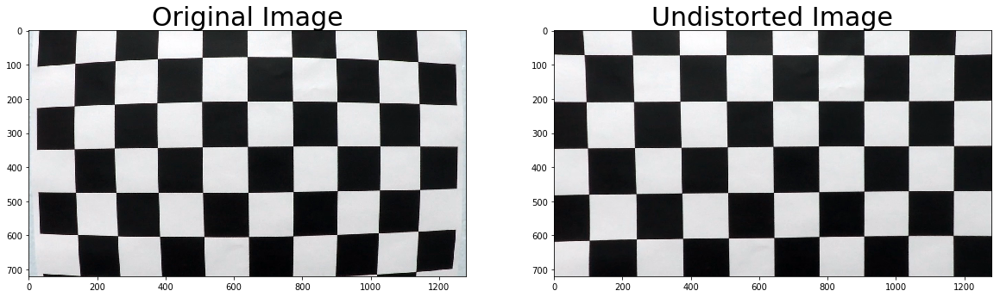

In [6]:
def test_undistortion():
    # Test undistortion on an image
    dist_img = cv2.imread('examples/test_cal_image.jpg')
    #Getting the image size
    img_size = (dist_img.shape[1], dist_img.shape[0])
    #calling the undistort function passing in the image , objpoints and imgpoints
    undist_image = undistort(dist_img, objpoints, imgpoints)
    # Saving the undistorted image to disk
    cv2.imwrite('examples/test_undist.jpg',undist_image)
    # Visualize undistortion
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(dist_img)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(undist_image)
    ax2.set_title('Undistorted Image', fontsize=30)
    f.savefig('output_images/undistorted image.jpg')
    
#test the above function on sample images to get undistorted image
test_undistortion()

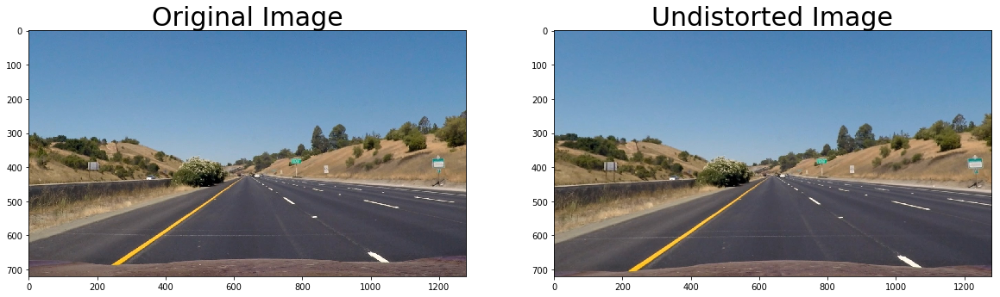

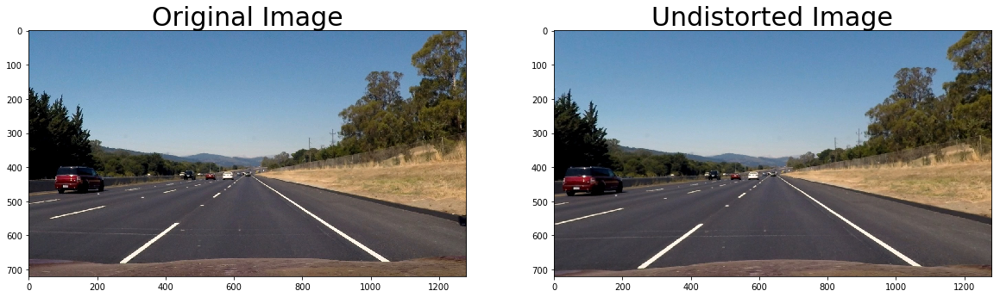

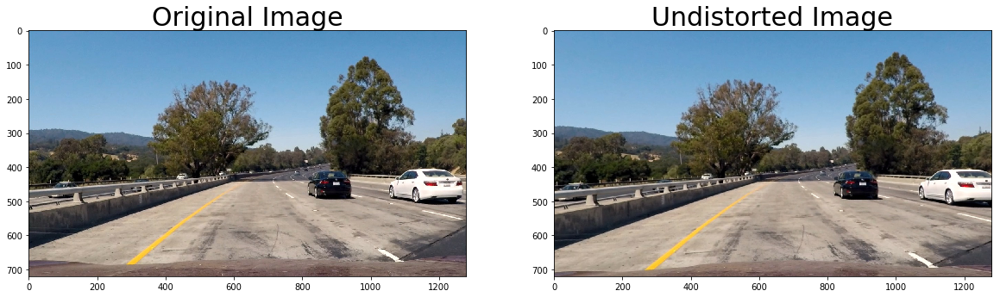

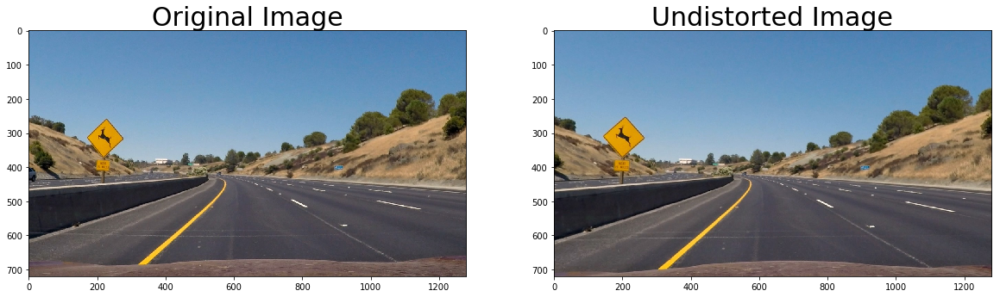

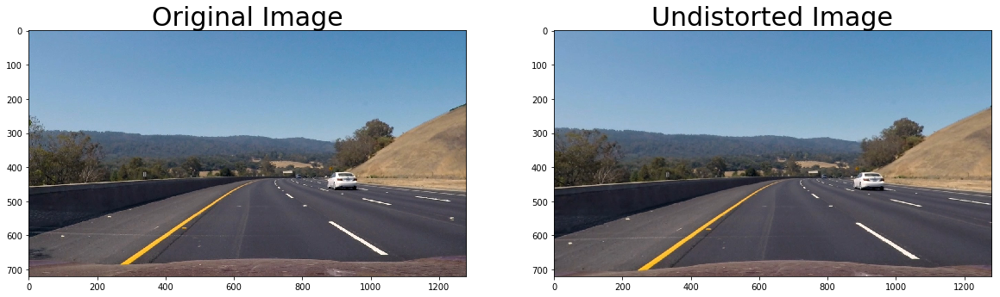

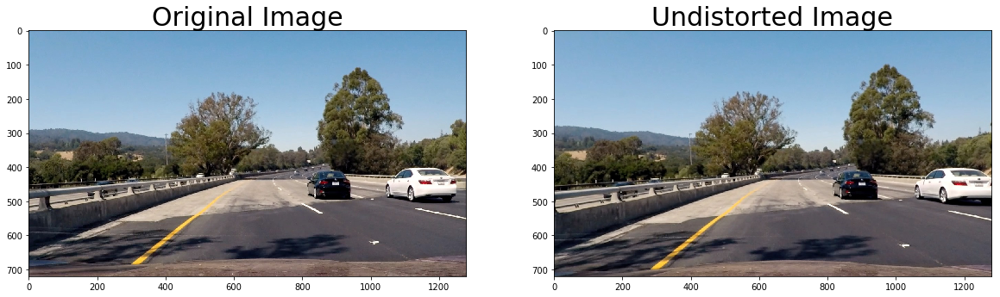

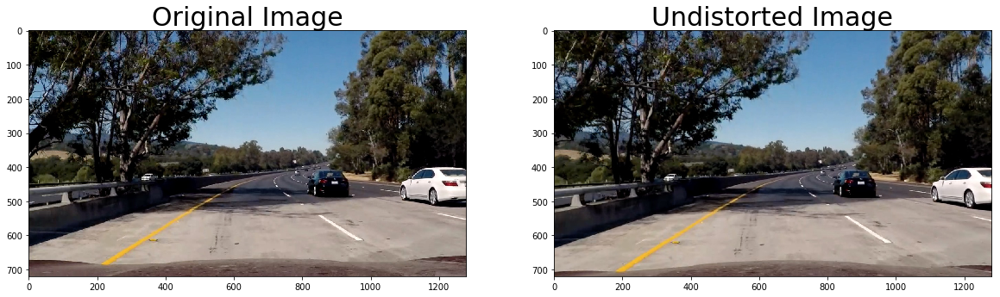

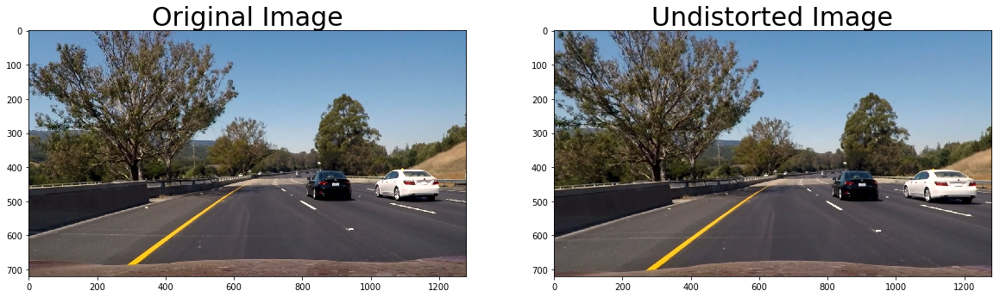

In [7]:
def testimages_undistort():
    images = glob.glob('test_images/*.jpg')

    for fname in images:
        img = cv2.imread(fname)
        img= cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        dst =undistort(img, objpoints, imgpoints)
        image_name=os.path.split(fname)[1]
        write_name = 'output_images/undistorted_'+image_name
        cv2.imwrite(write_name,dst)

        # Visualize undistortion on test images
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
        ax1.imshow(img)
        ax1.set_title('Original Image', fontsize=30)
        ax2.imshow(dst)
        ax2.set_title('Undistorted Image', fontsize=30)
        f.savefig(write_name)    
        
testimages_undistort()

In [8]:
# this is the function to get the color combination for good lane detection
def color_binary(image, s_thresh = (120,255), r_thresh = (220,255), l_thresh = (40,255)):
    img = np.copy(image)
    # We will find out which of the color channels from the color spaces basically RGB,HLS and Gray,
    # highlights the lane lines better. From RGB space, R seems to highlight lane better, amd S and l from HLS space
    # does a very good job. Will combine the three channels 
    # to get the most robust identification of the lines
    # Convert to RGB and separate out the R channel
    rgb =cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    r_channel = rgb[:,:,0]
    
    # Convert to HLS color space and separate the V channel
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    s_channel = hls[:,:,2]
    l_channel = hls[:,:,1]

    # Threshold for S-color channel
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel > s_thresh[0]) & (s_channel <= s_thresh[1])] = 1

    # Threshold for R-color channel
    r_binary = np.zeros_like(r_channel)
    r_binary[(r_channel > r_thresh[0]) & (r_channel <= r_thresh[1])] = 1

    # Threshold lightness
    l_binary = np.zeros_like(l_channel)
    l_binary[(l_channel >= l_thresh[0]) & (l_channel <= l_thresh[1])] = 1
    
    # Combine the two binary thresholds
    color_binary = np.zeros_like(s_binary)
    color_binary[(r_binary==1)|((s_binary == 1) & (l_binary==1))] = 1
    
    return color_binary

In [9]:
#Testing function for color threshold on sample images
def color_binary_images():
    #Sample testing of color_binary
    image = mpimg.imread('test_images/test2.jpg')
    undist_image= undistort(image,objpoints, imgpoints)
    color_bin = color_binary(undist_image, s_thresh = (170,255), r_thresh = (220,255), l_thresh = (130,200))

    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()

    ax1.imshow(undist_image)
    ax1.set_title('Original Image', fontsize=40)

    ax2.imshow(color_bin)
    ax2.set_title('Pipeline Result', fontsize=40)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    
#color_binary_images()

In [10]:
#Defining the functions for sobel gradient, sobel magnitude and sobel direction
def abs_sobel_thresh(image, orient='x', sobel_kernel=3, thresh=(0, 255)):
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    assert(orient == 'x' or orient == 'y'), "Orientation must be x or y"
    
    if orient == 'x':
        sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0,ksize = sobel_kernel)
        abs_sobelx = np.absolute(sobelx)
        scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    else:
        sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1,ksize = sobel_kernel)
        abs_sobely = np.absolute(sobely)
        scaled_sobel = np.uint8(255*abs_sobely/np.max(abs_sobely))
    
    grad_binary = np.zeros_like(scaled_sobel)
    grad_binary[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1
 
    return grad_binary

def mag_thresh(image, sobel_kernel=3, thresh=(0, 255)):
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize = sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize = sobel_kernel)
    
    abs_sobelxy = np.power((np.power(sobelx,2)+np.power(sobely,2)),0.5)
    
    scaled_sobel = np.uint8(255*abs_sobelxy/np.max(abs_sobelxy))
    
    mag_binary = np.zeros_like(scaled_sobel)
    mag_binary[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1
    
    return mag_binary

def dir_threshold(image, sobel_kernel=3, thresh=(0, np.pi/2)):
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    with np.errstate(divide='ignore', invalid='ignore'):
        absgraddir = np.absolute(np.arctan(sobely/sobelx))
        dir_binary =  np.zeros_like(absgraddir)
        dir_binary[(absgraddir >= thresh[0]) & (absgraddir <= thresh[1])] = 1

    return dir_binary

In [11]:
#combining the above sobel binary with the color binary to get a threshold that detects the lane properly
def combined_thresh(undist_image):
    # Choose a Sobel kernel size
    ksize = 9 # Choose a larger odd number to smooth gradient measurements

    color_bin = color_binary(undist_image, s_thresh = (170,255), r_thresh = (220,255), l_thresh = (130,200))
    # getting all the gradients, likes sobel x and y, magnitude gradient and direction gradient
    gradx = abs_sobel_thresh(undist_image, orient='x', sobel_kernel=ksize, thresh=(20, 155))
    grady = abs_sobel_thresh(undist_image, orient='y', sobel_kernel=ksize, thresh=(20,100))
    mag_binary = mag_thresh(undist_image, sobel_kernel=ksize, thresh=(30, 100))
    dir_binary = dir_threshold(undist_image, sobel_kernel=ksize, thresh=(0.7, 1.5))
    
    combined_sobel = np.zeros_like(gradx)
    #combining the sobel and color thresholds
    combined_sobel[(color_bin==1)|(gradx == 1) & (grady ==1)] = 1
    
    return combined_sobel

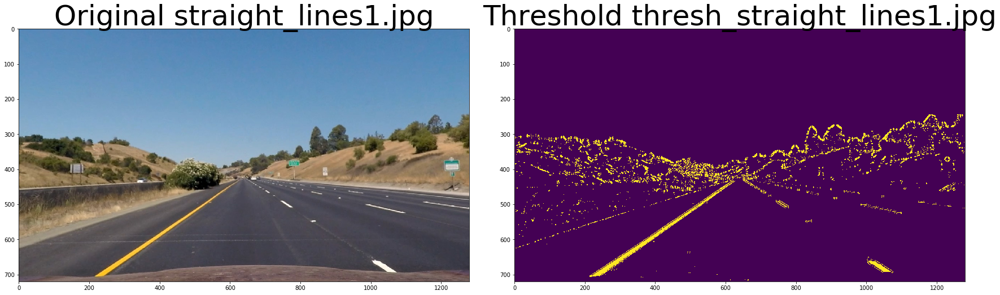

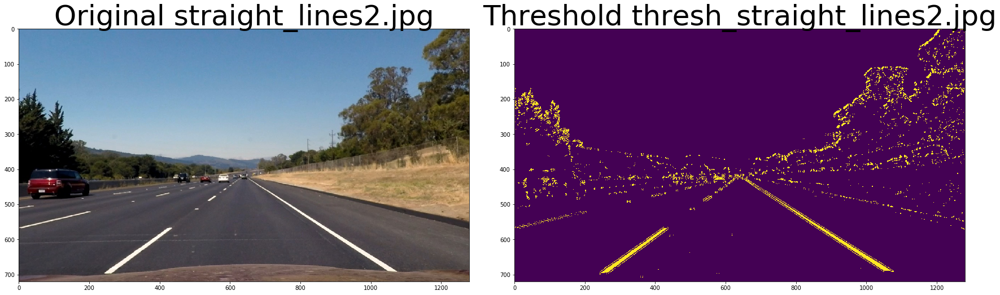

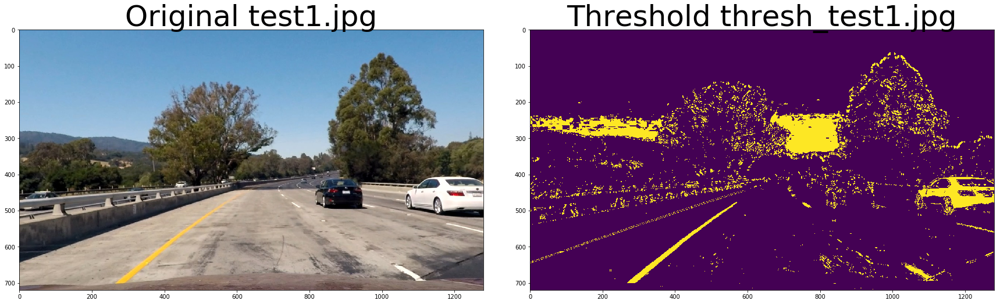

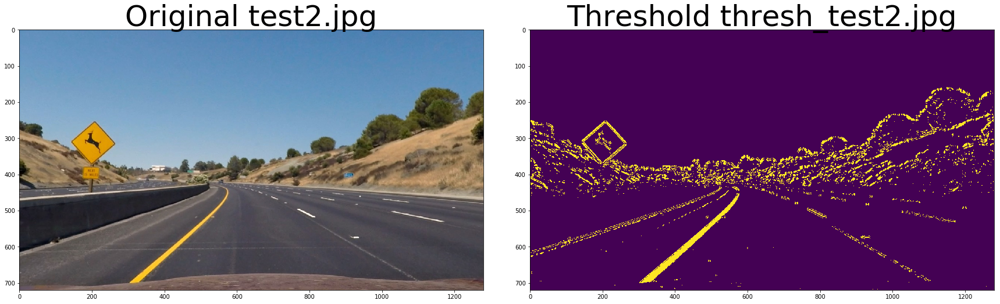

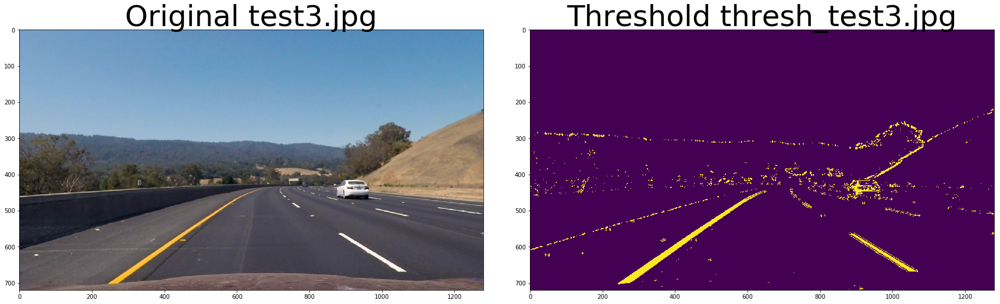

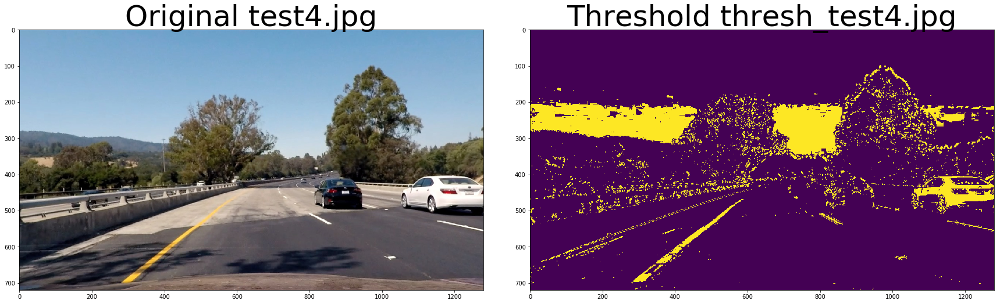

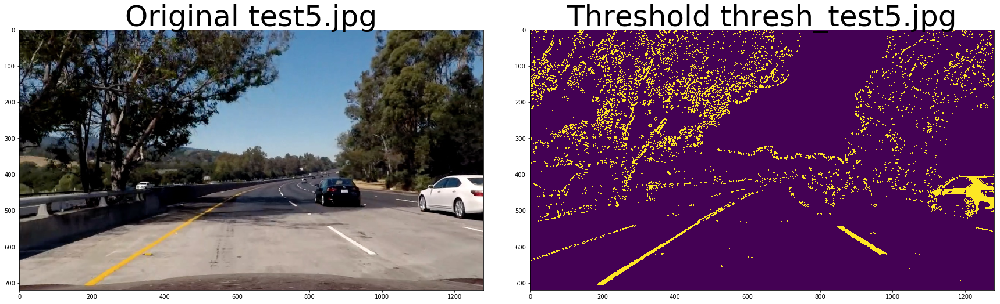

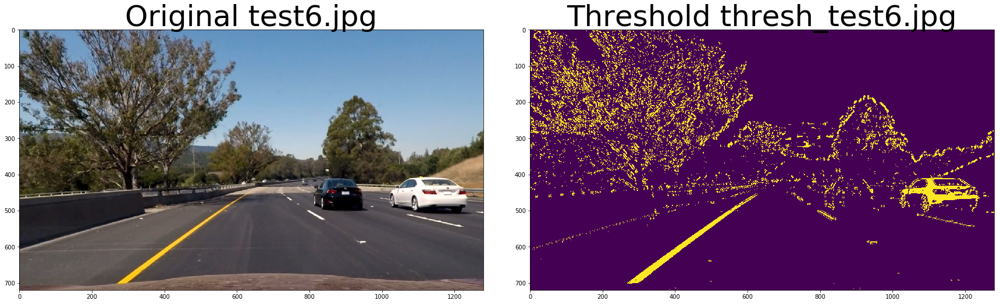

In [12]:
#testing the binary thresholds on sample images
def get_binary_transform_images():
    images = glob.glob('test_images/*.jpg')

    for fname in images:
        img = cv2.imread(fname)
        image_name=os.path.split(fname)[1]
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        undist_image= undistort(img,objpoints, imgpoints)
        combined = combined_thresh(undist_image)

        # Plot the result
        f, ((ax1,ax2)) = plt.subplots(1, 2, figsize=(24, 18))
        f.tight_layout()
        ax1.imshow(undist_image)
        ax1.set_title('Original '+ image_name, fontsize=50)
        ax2.imshow(combined)
        ax2.set_title('Threshold thresh_'+image_name, fontsize=50)
        plt.subplots_adjust(hspace=0.2, wspace=0.1)
        f.savefig('output_images/thresh_'+image_name)

get_binary_transform_images()

In [15]:
#function to get the perspective transform
def warper(image):
    #Compute the source and destination points for warping

    corners = np.float32([[253, 697], [585, 456], [700, 456], [1061, 690]])

    new_top_left = np.array([corners[0, 0], 0])
    new_top_right = np.array([corners[3, 0], 0])
    offset = [50, 0]
    
    img_size = (image.shape[1], image.shape[0])
    
    src = np.float32([corners[0], corners[1], corners[2], corners[3]])
    dst = np.float32([corners[0] + offset, new_top_left + offset, new_top_right - offset, corners[3] - offset])

    #print('src---', src)
    #print('dst---',dst)
    # Compute and apply perpective transform
    img_size = (image.shape[1], image.shape[0])
    M = cv2.getPerspectiveTransform(src, dst)
    Minv = cv2.getPerspectiveTransform(dst, src)
    warped = cv2.warpPerspective(image, M, img_size, flags=cv2.INTER_NEAREST)  # keep same size as input image
    return warped, M, Minv


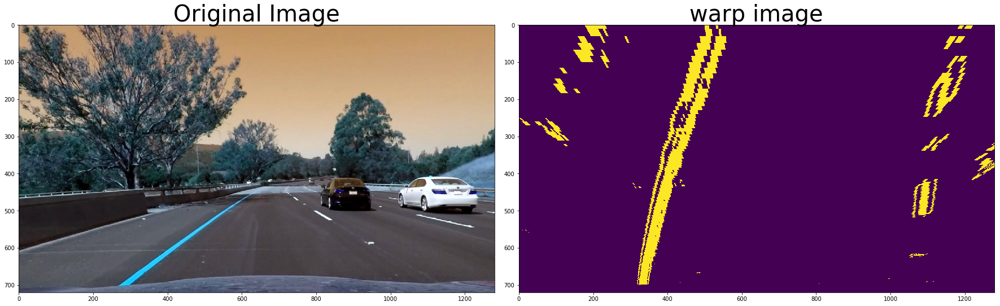

In [16]:
#sample testing of the perspective transform on the test images
def get_perspective_transform():
    testimage =  cv2.imread('test_images/test6.jpg')
    undist_image= undistort(testimage,objpoints, imgpoints)
    combined = combined_thresh(undist_image)
    warp,_,_ = warper(combined)
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()

    ax1.imshow(undist_image)
    ax1.set_title('Original Image', fontsize=40)

    ax2.imshow(warp)
    ax2.set_title('warp image', fontsize=40)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    
get_perspective_transform()

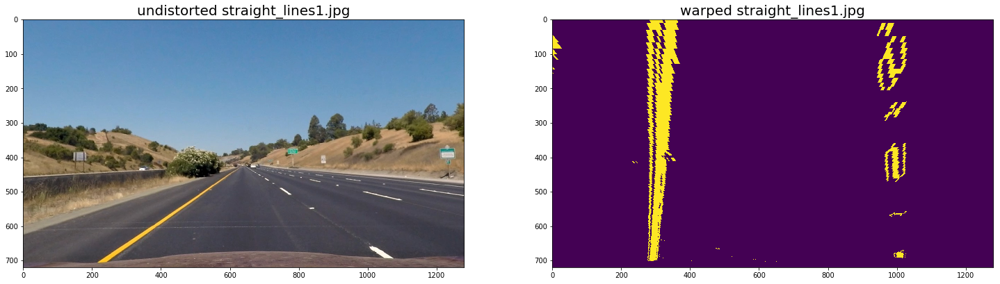

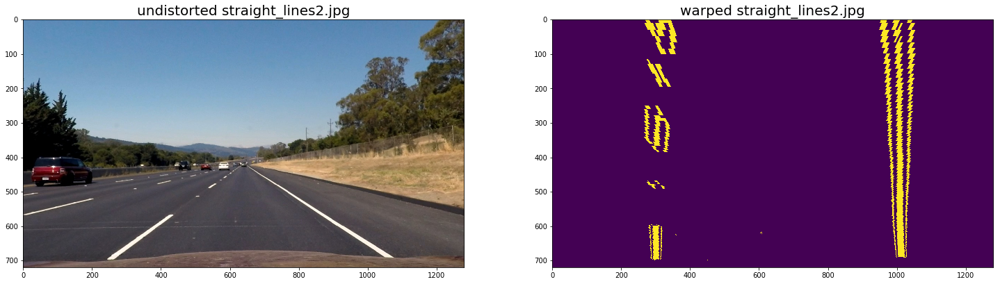

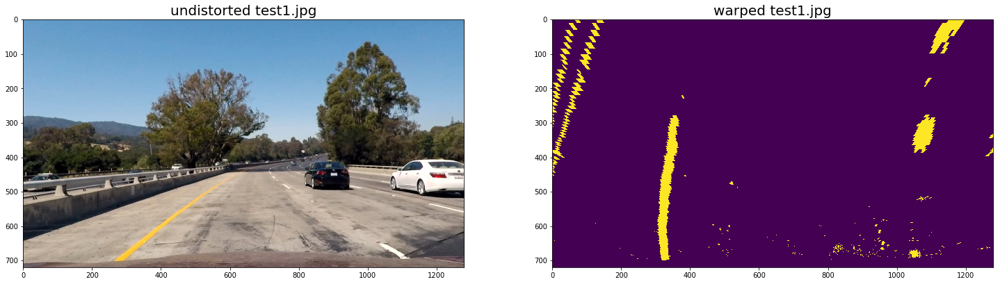

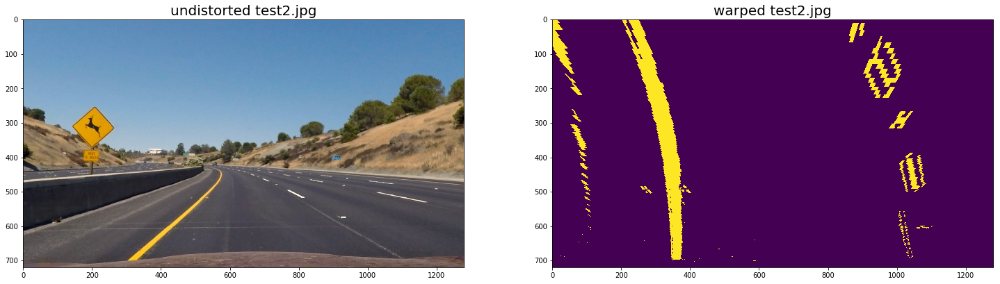

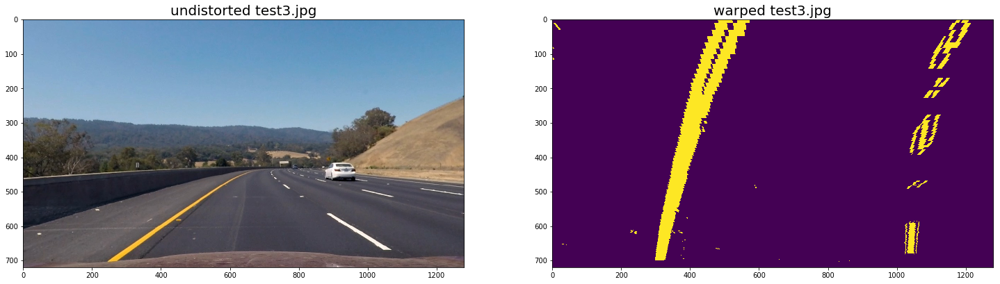

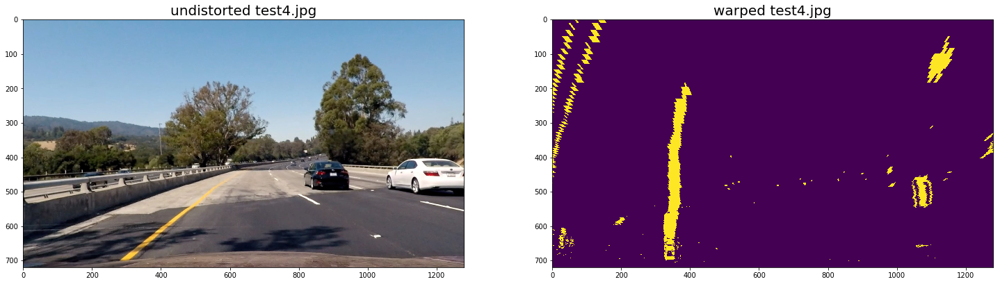

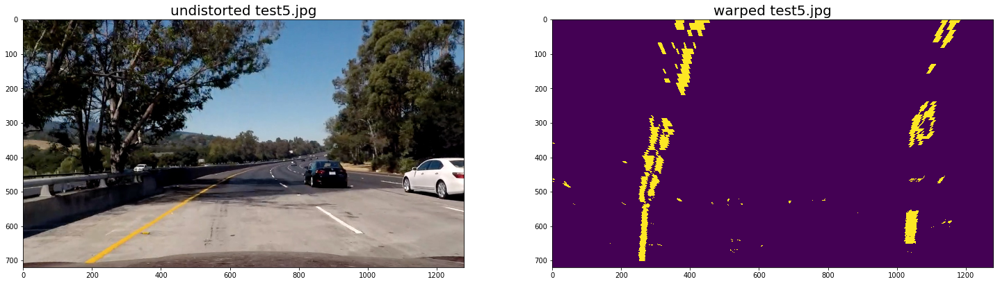

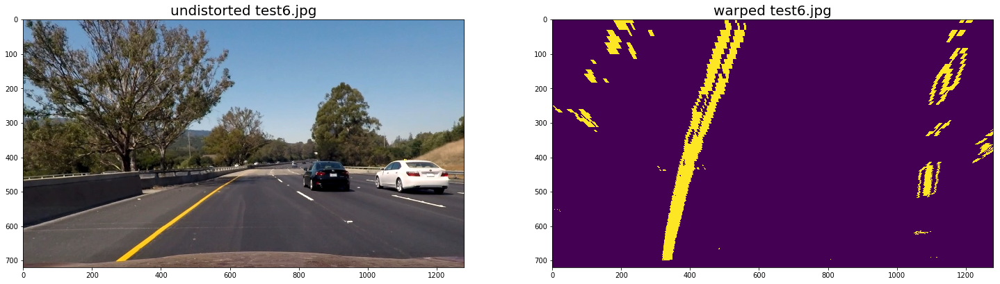

In [17]:
def perspective_transform():
    #Sample testing of the warping
    images = glob.glob('test_images/*.jpg')

    # Step through the list and search for chessboard corners
    for fname in images:
        img = cv2.imread(fname)
        image_name=os.path.split(fname)[1]
        test_image = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        img_size = (test_image.shape[1], test_image.shape[0])

        # Undistort the test images
        undist = undistort(test_image, objpoints, imgpoints)

        # get the combined threshold binary
        combined = combined_thresh(undist)

        # warp the images for a bird eye view
        binary_warped, M, Minv = warper(combined)
        #Taking a histogram of the bottom half of the image
        histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)

        f, ((ax1, ax2)) = plt.subplots(1, 2, figsize=(25,7))
        ax1.imshow(undist)
        ax1.set_title('undistorted ' + image_name , fontsize=20)
        ax2.imshow(binary_warped)
        ax2.set_title('warped '+ image_name, fontsize=20)
        f.savefig('output_images/warped ' + image_name)
        
perspective_transform()

In [18]:
def get_curvature(leftx, lefty, rightx, righty, ploty, image_size):
    y_eval = np.max(ploty)
    
    # Calculate curvature in pixel-space.
    
    #left_curverad = ((1 + (2*left_fit[0]*y_eval + left_fit[1])**2)**1.5) / np.absolute(2*left_fit[0])
    #right_curverad = ((1 + (2*right_fit[0]*y_eval + right_fit[1])**2)**1.5) / np.absolute(2*right_fit[0])
    #print(left_curverad, right_curverad)
    ## Example values: 1926.74 1908.48
    
    # Convert from pixels to metres.
    
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    
    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)
    
    # Calculate the new radii of curvature
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    #print('left_curverad-----', left_curverad)
    #print('right_curverad----', right_curverad)
    
    # Now our radius of curvature is in meters
    # Example values: 632.1 m    626.2 m
    
    # Calculate Lane Deviation from center of lane:
    # First we calculate the intercept points at the bottom of our image, then use those to 
    # calculate the lane deviation of the vehicle (assuming camera is in center of vehicle)
    scene_height = image_size[0] * ym_per_pix
    scene_width = image_size[1] * xm_per_pix
    
    left_intercept = left_fit_cr[0] * scene_height ** 2 + left_fit_cr[1] * scene_height + left_fit_cr[2]
    right_intercept = right_fit_cr[0] * scene_height ** 2 + right_fit_cr[1] * scene_height + right_fit_cr[2]
    calculated_center = (left_intercept + right_intercept) / 2.0
    
    lane_deviation = (calculated_center - scene_width / 2.0)
    #print('lane_deviation----------', lane_deviation)
    return left_curverad, right_curverad, lane_deviation

In [19]:
def find_lane_pixels(binary_warped):
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

   
    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 9
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),
        (win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),
        (win_xright_high,win_y_high),(0,255,0), 2) 
        
        # Identify the nonzero pixels in x and y within the window #
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        # Avoids an error if the above is not implemented fully
        pass

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    return leftx, lefty, rightx, righty, out_img

In [20]:
def fit_polynomial(binary_warped):
    # Find our lane pixels first
    leftx, lefty, rightx, righty, out_img = find_lane_pixels(binary_warped)

    # Fit a second order polynomial to each using `np.polyfit`
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    try:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
        print('The function failed to fit a line!')
        left_fitx = 1*ploty**2 + 1*ploty
        right_fitx = 1*ploty**2 + 1*ploty

    # setting the history class Line for first left and right line points
    left.current_fit_xvals=left_fitx
    left.allx = leftx
    left.ally = lefty
    right.current_fit_xvals=right_fitx
    right.allx = rightx
    right.ally = righty
    left.current_fit_coeff=left_fit
    right.current_fit_coeff=right_fit
    left.update()
    right.update()
    
    ## Visualization ##
    # Colors in the left and right lane regions
    out_img[lefty, leftx] = [255, 0, 0]
    out_img[righty, rightx] = [0, 0, 255]

    l, r, d = get_curvature(leftx, lefty, rightx, righty, ploty, binary_warped.shape)

    #setting the radius of curvature into the line class
    left.radius_of_curvature = l
    right.radius_of_curvature =r
    
    # Plots the left and right polynomials on the lane lines
    #plt.plot(left_fitx, ploty, color='yellow')
    #plt.plot(right_fitx, ploty, color='yellow')

    return out_img, left_fit,right_fit

In [21]:
class Line():
    def __init__(self,n=5):


        # length of queue to store data
        self.n = n
        #number of fits in buffer
        self.n_buffered = 0

        # was the line detected in the last iteration?
        self.detected = False  

        #x values for detected line pixels
        self.allx = None  
        #y values for detected line pixels
        self.ally = None          
        
        # x values of the last n fits of the line
        self.recent_fit_xvals = deque([],maxlen=n) 
        #average x values of the fitted line over the last n iterations
        self.best_fit_xvals = None     
        # xvals of most recent fits
        self.current_fit_xvals =[np.array([False])]
        
        #polynomial coefficients averaged over the last n iterations
        self.best_fit_coeff = None  
        #polynomial coefficients for the most recent fit
        self.current_fit_coeff = [np.array([False])]  
        # coefficients of the last n fits of the line
        self.recent_fit_coeff = deque([], maxlen=n)
        
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float') 

        #radius of curvature of the line in some units
        self.radius_of_curvature = [np.array([False])] 
        #radius of curvature of the last n lines
        self.recent_roc = deque([],maxlen=n)
        #average roc of the line over last n iterations
        self.best_roc =None

        #distance in meters of vehicle center from the line
        self.line_base_pos = None 
        #origin of the fitted line at the bottom of the image
        self.line_pos = None
        #y values for line fit
        self.fit_yvals = np.linspace(0, 719, 720)  # always the same y-range as image
       
        
    def add_data(self):
        self.recent_fit_xvals.append(self.current_fit_xvals)
        self.recent_fit_coeff.append(self.current_fit_coeff)
        self.recent_roc.append(self.radius_of_curvature)
        self.n_buffered = len(self.recent_fit_xvals)
        #print('nbuffered--', self.n_buffered)
        
        
    def set_best_fit_xvals(self):
        fits = self.recent_fit_xvals
        if len(fits)>0:
            avg=0
            for fit in fits:
                avg +=np.array(fit)
            avg = avg / len(fits)
            self.best_fit_xvals = avg

    def set_best_roc(self):
        fits = self.recent_roc
        if len(fits)>0:
            avg=0
            for fit in fits:
                avg +=np.array(fit).astype('float64')
            avg = avg / len(fits)
            self.best_roc = avg
            
            
    def set_best_fit_coeffs(self):
        coeffs = self.recent_fit_coeff
        if len(coeffs)>0:
            avg=0
            for coeff in coeffs:
                avg +=np.array(coeff)
            avg = avg / len(coeffs)
            self.best_fit_coeff = avg
        #print('average coeff--', self.best_fit_coeff)
    
  
    def set_diffs(self):
        if self.n_buffered>0:
            self.diffs = self.current_fit_coeff - self.best_fit_coeff
        else:
            self.diffs = np.array([0,0,0], dtype='float')
        #print('self.diffs----', self.diffs)
        
            
    def update(self):
        self.detected = True
        self.add_data()
        self.set_best_fit_xvals()
        self.set_best_fit_coeffs()
        self.set_best_roc()
        self.set_diffs()
            

In [22]:
def fit_poly(img_shape, leftx, lefty, rightx, righty):
     ### TO-DO: Fit a second order polynomial to each with np.polyfit() ###
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    # Generate x and y values for plotting
    ploty = np.linspace(0, img_shape[0]-1, img_shape[0])
    ### TO-DO: Calc both polynomials using ploty, left_fit and right_fit ###
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    return left_fitx, right_fitx, ploty

In [23]:
def search_around_poly(binary_warped, left_fit,right_fit):
    # HYPERPARAMETER
    # Choose the width of the margin around the previous polynomial to search
    # The quiz grader expects 100 here, but feel free to tune on your own!
    margin = 100

    #left_fit = np.polyfit(lefty, leftx, 2)
    #right_fit = np.polyfit(righty, rightx, 2)

    
    # Grab activated pixels
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    ### TO-DO: Set the area of search based on activated x-values ###
    ### within the +/- margin of our polynomial function ###
    ### Hint: consider the window areas for the similarly named variables ###
    ### in the previous quiz, but change the windows to our new search area ###
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
                    left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
                    left_fit[1]*nonzeroy + left_fit[2] + margin)))
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
                    right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
                    right_fit[1]*nonzeroy + right_fit[2] + margin)))
    
    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    # Fit new polynomials
    left_fitx, right_fitx, ploty = fit_poly(binary_warped.shape, leftx, lefty, rightx, righty)

    # setting the history class Line for first left and right line points
    left.current_fit_xvals=left_fitx
    left.allx = leftx
    left.ally = lefty
    right.current_fit_xvals=right_fitx
    right.allx = rightx
    right.allx = righty
    left.current_fit_coeff=left_fit
    right.current_fit_coeff=right_fit
    left.update()
    right.update()
     
    ## Visualization ##
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    window_img = np.zeros_like(out_img)
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, 
                              ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, 
                              ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    
    l, r, d = get_curvature(leftx, lefty, rightx, righty, ploty, binary_warped.shape)

    #setting the radius of curvature into the line class
    left.radius_of_curvature = l
    right.radius_of_curvature =r
    
    # Plot the polynomial lines onto the image

    #plt.plot(left_fitx, ploty, color='yellow')
    #plt.plot(right_fitx, ploty, color='yellow')

    ## End visualization steps ##
    
    return result, left_fitx, right_fitx, ploty, l, r, d

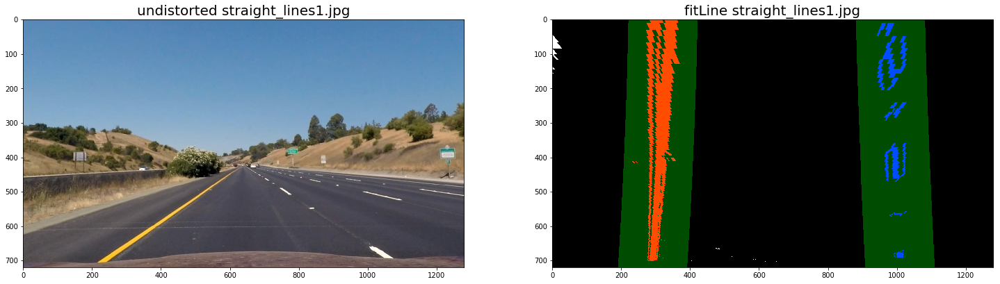

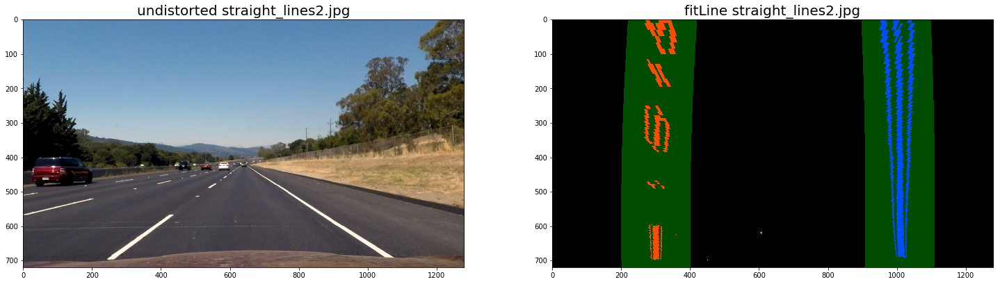

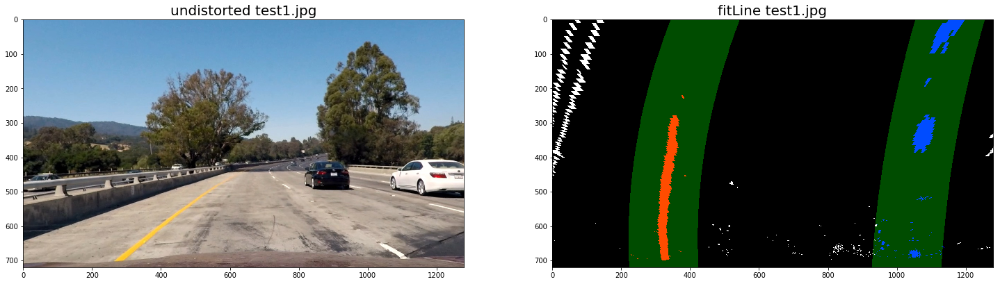

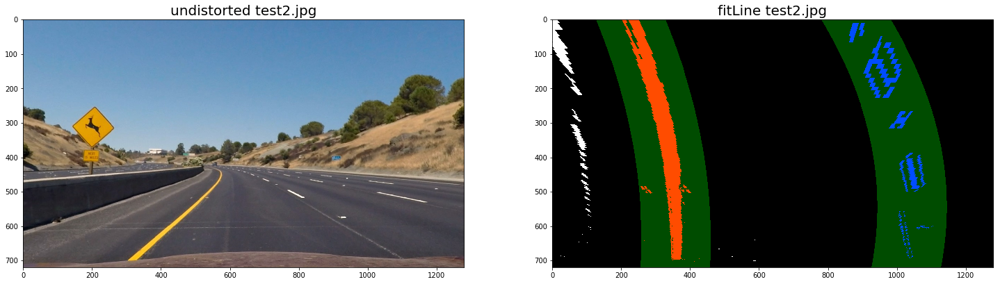

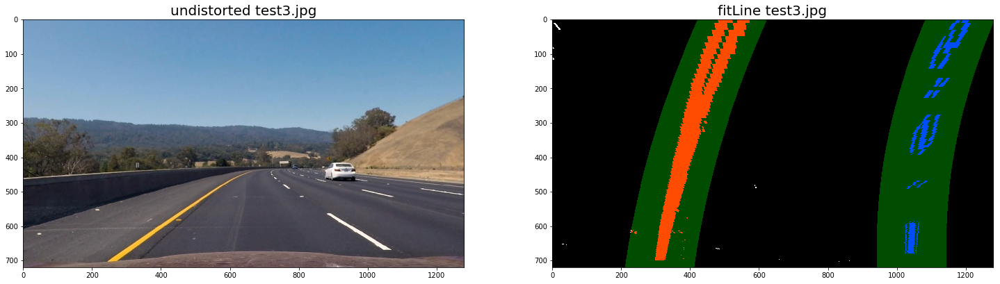

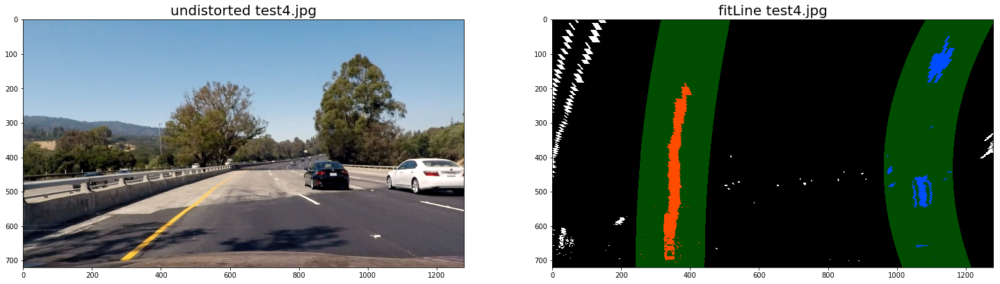

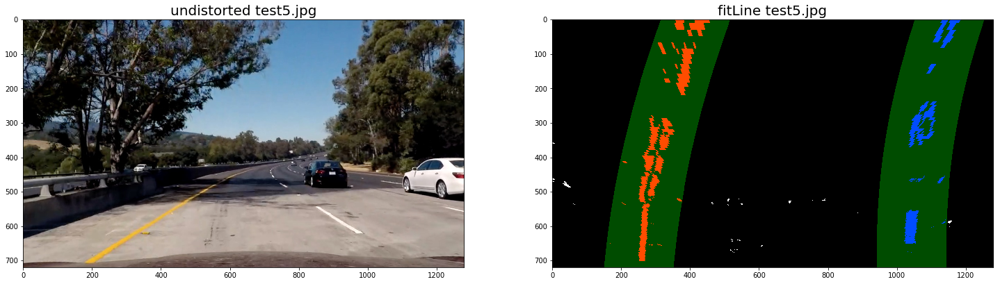

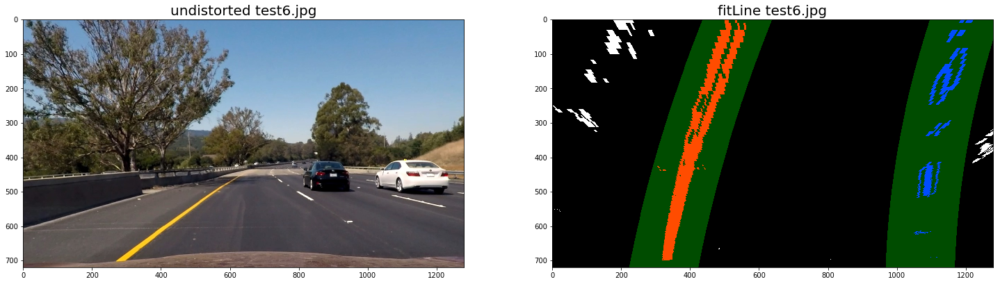

In [24]:
left=Line()
right=Line()
def get_lines():
    #Sample testing of the warping
    images = glob.glob('test_images/*.jpg')

    # Step through the list and search for chessboard corners
    for fname in images:
        img = cv2.imread(fname)
        image_name=os.path.split(fname)[1]
        test_image = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        img_size = (test_image.shape[1], test_image.shape[0])

        # Undistort the test images
        undist = undistort(test_image, objpoints, imgpoints)

        # get the combined threshold binary
        combined = combined_thresh(undist)

        # warp the images for a bird eye view
        binary_warped, M, Minv = warper(combined)
        # Find our lane pixels first
        out_img,left_fit,right_fit= fit_polynomial(binary_warped)
        result,left_fitx,right_fitx,ploty, l,r,d  = search_around_poly(binary_warped, left.current_fit_coeff, right.current_fit_coeff)      
        
        f, ((ax1, ax2)) = plt.subplots(1, 2, figsize=(25,7))
        ax1.imshow(undist)
        ax1.set_title('undistorted ' + image_name , fontsize=20)
        ax2.imshow(result)
        ax2.set_title('fitLine '+ image_name, fontsize=20)
        f.savefig('output_images/fitline_' + image_name)
        
get_lines()

In [25]:
def draw_lanes_on_image(binary_warped, undistorted_img, Minv, left_fitx, right_fitx, ploty, left_radius, right_radius, lane_deviation):
    """
    Draw the found lane lines onto a binary warped image, then unwarp
    and overlay on the original image.
    
    binary_warped
    Minv
    left_fitx
    right_fitx
    ploty
    """
     
    # Create a blank image to draw the lines on
    warp_zero = np.zeros_like(binary_warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    
    #left_fitx, right_fitx = get_smoothed_predictions()
    
    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))
    
    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0, 255, 0))
    
    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (undistorted_img.shape[1], undistorted_img.shape[0])) 
    
    # Combine the result with the original image
    result = cv2.addWeighted(undistorted_img, 1, newwarp, 0.3, 0)
    
    left_radius, right_radius =get_smoothed_radius()
    
    curvature_text = "Curvature: Left = " + str(np.round(left_radius, 2)) + ", Right = " + str(np.round(right_radius, 2)) 
    font = cv2.FONT_HERSHEY_COMPLEX    
    cv2.putText(result, curvature_text, (30, 60), font, 1, (0,255,0), 2)
    deviation_text = "Lane deviation from center = {:.2f} m".format(lane_deviation) 
    font = cv2.FONT_HERSHEY_COMPLEX    
    cv2.putText(result, deviation_text, (30, 90), font, 1, (0,255,0), 2)
        
    return result


In [27]:
##Checking for Sanity of the lines
def check_validlines():
    # checking for valid lines
    valid_left_found  = (len(left.allx) > 0) &\
                        (len(left.ally) > 0)

    valid_right_found = (len(right.allx) > 0) &\
                        (len(right.ally) > 0)
    return valid_left_found, valid_right_found

def get_smoothed_predictions():
    left_fitx  = left.best_fit_xvals
    right_fitx = right.best_fit_xvals
    return left_fitx, right_fitx

def get_smoothed_radius():
    radius_left = left.best_roc
    radius_right=right.best_roc

    return radius_left,radius_right

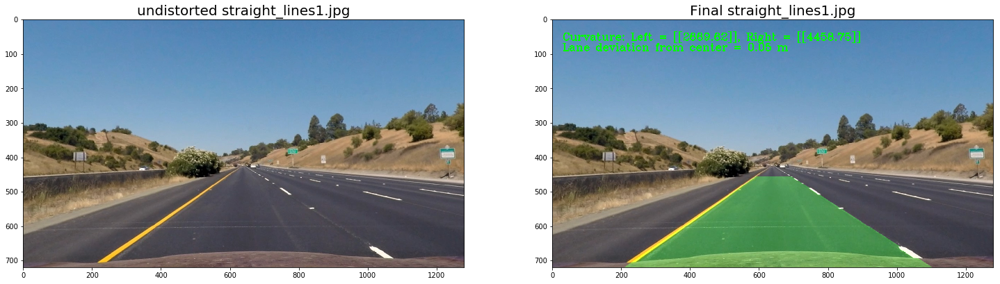

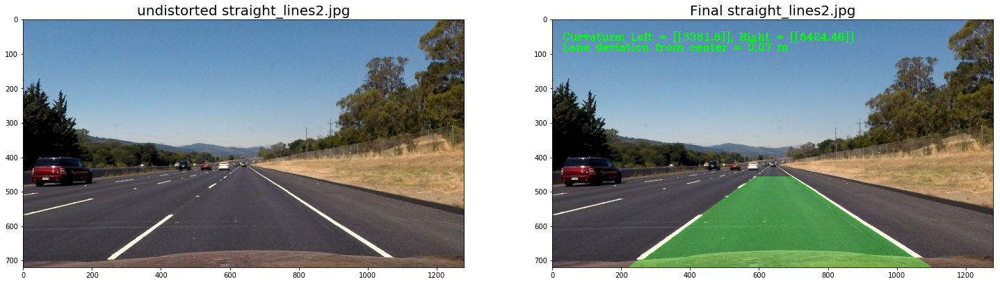

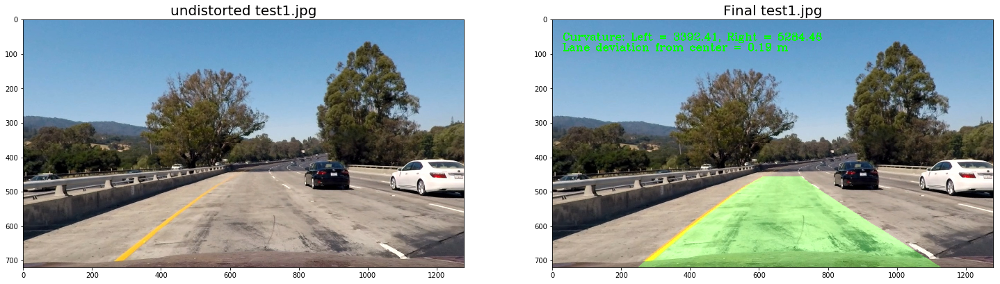

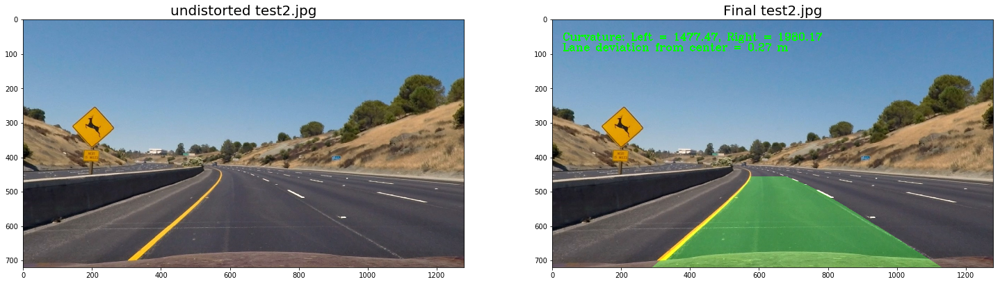

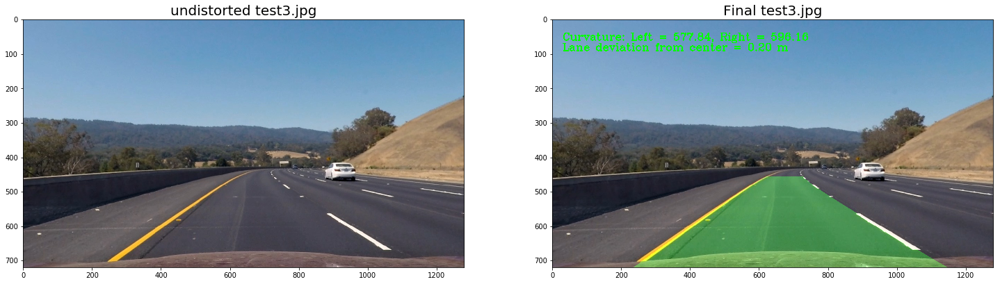

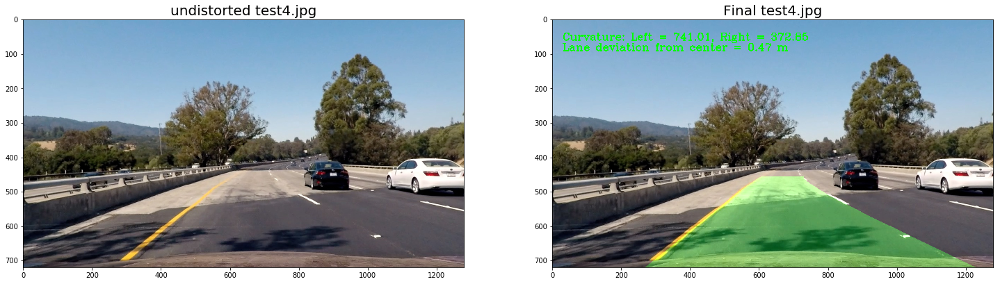

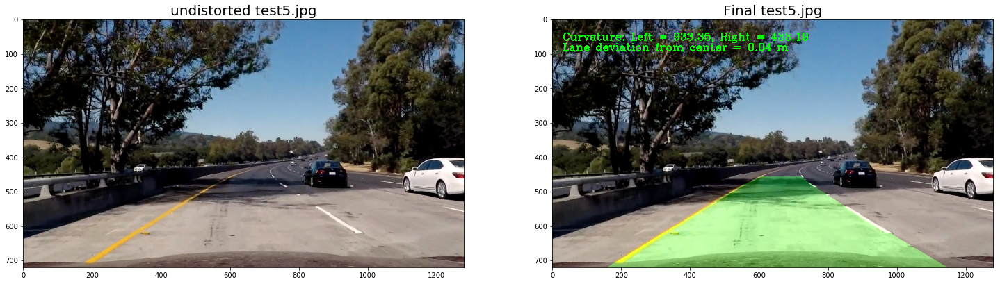

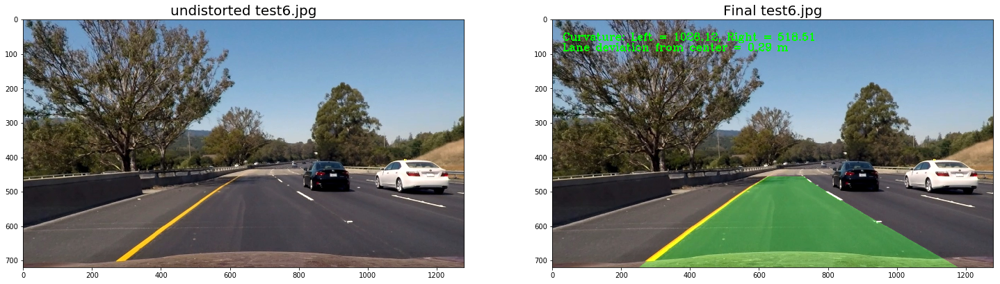

In [28]:
left=Line()
right=Line()
def get_final_plotted_image():
    #Sample testing of the warping
    images = glob.glob('test_images/*.jpg')

    # Step through the list and search for chessboard corners
    for fname in images:
        img = cv2.imread(fname)
        image_name=os.path.split(fname)[1]
        test_image = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        img_size = (test_image.shape[1], test_image.shape[0])

        # Undistort the test images
        undist = undistort(test_image, objpoints, imgpoints)

        # get the combined threshold binary
        combined = combined_thresh(undist)

        # warp the images for a bird eye view
        binary_warped, M, Minv = warper(combined)
        # Find our lane pixels first
        out_img,left_fit,right_fit= fit_polynomial(binary_warped)
        result,left_fitx,right_fitx,ploty, l,r,d  = search_around_poly(binary_warped, left.current_fit_coeff, right.current_fit_coeff)      
        lane_lines_img = draw_lanes_on_image(binary_warped, undist, Minv, left_fitx, right_fitx, ploty, l, r, d)        

        f, ((ax1, ax2)) = plt.subplots(1, 2, figsize=(25,7))
        ax1.imshow(undist)
        ax1.set_title('undistorted ' + image_name , fontsize=20)
        ax2.imshow(lane_lines_img)
        ax2.set_title('Final '+ image_name, fontsize=20)
        f.savefig('output_images/final_' + image_name)
        
get_final_plotted_image()

In [29]:
left=Line()
right=Line()

In [30]:
def process_image(image):
    """
    Execute our image processing pipeline on the provided image.
    """
    # Run image through the pipeline
    # Note that in your project, you'll also want to feed in the previous fits
    undistorted = undistort(image, objpoints, imgpoints)

    # get the combined threshold binary
    combined = combined_thresh(undistorted)
    # warp the images for a bird eye view
    binary_warped, M, Minv = warper(combined)

    if left.n_buffered==0 or right.n_buffered==0:
        out_img,left_fit,right_fit = fit_polynomial(binary_warped)
        left.current_fit_coeff = left_fit
        right.current_fit_coeff = right_fit
        #print(left.current_fit_coeff , left_fit)

    ## checking if the lanes found are valid or not
    # Note that in your project, you'll also want to feed in the previous fits
    result, left_fitx, right_fitx, ploty,l,r,d = search_around_poly(binary_warped, left.current_fit_coeff, right.current_fit_coeff)
    lane_lines_img = draw_lanes_on_image(binary_warped, undistorted, Minv, left_fitx, right_fitx, ploty, l, r, d)
    
    return lane_lines_img

In [31]:
video_output = "videoimages/project_video_output.mp4"
clip1 = VideoFileClip("project_video.mp4")
clip1_output = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time clip1_output.write_videofile(video_output, audio=False)

[MoviePy] >>>> Building video videoimages/project_video_output.mp4
[MoviePy] Writing video videoimages/project_video_output.mp4


100%|█████████▉| 1260/1261 [53:45<00:02,  2.36s/it]


[MoviePy] Done.
[MoviePy] >>>> Video ready: videoimages/project_video_output.mp4 

Wall time: 53min 48s
